# РОЗРАХУНКОВО-ГРАФІЧНА РОБОТА З ДИСЦИПЛІНИ "МАШИНЕ НАВЧАННЯ"

Зробив 
студент 3 курсу
групи ДА-81
Головін Богдан

Посилання на завдання
https://www.kaggle.com/c/house-prices-advanced-regression-techniques

## Підключення файлів та бібліотек

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import csv
import random
import warnings
warnings.filterwarnings('ignore')

from sklearn.metrics import explained_variance_score, r2_score, mean_absolute_percentage_error, max_error, mean_absolute_error,mean_absolute_percentage_error, mean_squared_error
from sklearn.base import clone
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import ElasticNet, Lasso
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.model_selection import KFold
import xgboost as xgb
import lightgbm as lgb

In [2]:

# Сброс ограничений на количество выводимых рядов
pd.set_option('display.max_rows', None)
 
# Сброс ограничений на число столбцов
pd.set_option('display.max_columns', None)
 
# Сброс ограничений на количество символов в записи
pd.set_option('display.max_colwidth', None)

# Открываем тренировочные данные
data_train = pd.read_csv('train.csv')
print('Размер train: ', data_train.shape)
data_train.head(20)

Размер train:  (1460, 81)


,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
5,6,50,RL,85.0,14115,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,732,Unf,0,64,796,GasA,Ex,Y,SBrkr,796,566,0,1362,1,0,1,1,1,1,TA,5,Typ,0,NaN,Attchd,1993.0,Unf,2,480,TA,TA,Y,40,30,0,320,0,0,NaN,MnPrv,Shed,700,10,2009,WD,Normal,143000
6,7,20,RL,75.0,10084,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,1369,Unf,0,317,1686,GasA,Ex,Y,SBrkr,1694,0,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Gd,Attchd,2004.0,RFn,2,636,TA,TA,Y,255,57,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,307000
7,8,60,RL,NaN,10382,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240.0,TA,TA,CBlock,Gd,TA,Mn,ALQ,859,BLQ,32,216,1107,GasA,Ex,Y,SBrkr,1107,983,0,2090,1,0,2,1,3,1,TA,7,Typ,2,TA,Attchd,1973.0,RFn,2,484,TA,TA,Y,235,204,228,0,0,0,NaN,NaN,Shed,350,11,2009,WD,Normal,200000
8,9,50,RM,51.0,6120,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,952,952,GasA,Gd,Y,FuseF,1022,752,0,1774,0,0,2,0,2,2,TA,8,Min1,2,TA,Detchd,1931.0,Unf,2,468,Fa,TA,Y,90,0,205,0,0,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml,129900
9,10,190,RL,50.0,7420,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,1939,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,BrkTil,TA,TA,No,GLQ,851,Unf,0,140,991,Gas

In [3]:
# Открываем тестовые данные (для изменения для послудующей проверки)
data_test = pd.read_csv('test.csv')
print('Размер test: ', data_test.shape)
data_test.head()

Размер test:  (1459, 80)


,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,1461,20,RH,80.0,11622,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Feedr,Norm,1Fam,1Story,5,6,1961,1961,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,468.0,LwQ,144.0,270.0,882.0,GasA,TA,Y,SBrkr,896,0,0,896,0.0,0.0,1,0,2,1,TA,5,Typ,0,NaN,Attchd,1961.0,Unf,1.0,730.0,TA,TA,Y,140,0,0,0,120,0,NaN,MnPrv,NaN,0,6,2010,WD,Normal
1,1462,20,RL,81.0,14267,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NAmes,Norm,Norm,1Fam,1Story,6,6,1958,1958,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,108.0,TA,TA,CBlock,TA,TA,No,ALQ,923.0,Unf,0.0,406.0,1329.0,GasA,TA,Y,SBrkr,1329,0,0,1329,0.0,0.0,1,1,3,1,Gd,6,Typ,0,NaN,Attchd,1958.0,Unf,1.0,312.0,TA,TA,Y,393,36,0,0,0,0,NaN,NaN,Gar2,12500,6,2010,WD,Normal
2,1463,60,RL,74.0,13830,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,5,5,1997,1998,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,GLQ,791.0,Unf,0.0,137.0,928.0,GasA,Gd,Y,SBrkr,928,701,0,1629,0.0,0.0,2,1,3,1,TA,6,Typ,1,TA,Attchd,1997.0,Fin,2.0,482.0,TA,TA,Y,212,34,0,0,0,0,NaN,MnPrv,NaN,0,3,2010,WD,Normal
3,1464,60,RL,78.0,9978,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,6,1998,1998,Gable,CompShg,VinylSd,VinylSd,BrkFace,20.0,TA,TA,PConc,TA,TA,No,GLQ,602.0,Unf,0.0,324.0,926.0,GasA,Ex,Y,SBrkr,926,678,0,1604,0.0,0.0,2,1,3,1,Gd,7,Typ,1,Gd,Attchd,1998.0,Fin,2.0,470.0,TA,TA,Y,360,36,0,0,0,0,NaN,NaN,NaN,0,6,2010,WD,Normal
4,1465,120,RL,43.0,5005,Pave,NaN,IR1,HLS,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1992,1992,Gable,CompShg,HdBoard,HdBoard,None,0.0,Gd,TA,PConc,Gd,TA,No,ALQ,263.0,Unf,0.0,1017.0,1280.0,GasA,Ex,Y,SBrkr,1280,0,0,1280,0.0,0.0,2,0,2,1,Gd,5,Typ,0,NaN,Attchd,1992.0,RFn,2.0,506.0,TA,TA,Y,0,82,0,0,144,0,NaN,NaN,NaN,0,1,2010,WD,Normal


## EDA

Для початку подивимося кількість фич кожного типу. Та подивимося на графік густини нашого таргету 'SalePrice'. Він трохи схож на графік нормального розподілу, але зміщенний уліво

In [4]:
# Количество столбцов каждого типа
num_train = data_train.select_dtypes(include = ['float64', 'int64'])
data_train.dtypes.value_counts()

object     43
int64      35
float64     3
dtype: int64

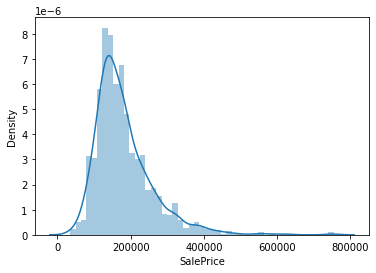

In [5]:
sns.distplot(data_train['SalePrice']);

Треба обробити пропущенні значення. Для цього робимо нову таблицю з процентною характеристикою фич на пропущенні значення. А поті спираючись на неї видаляемо фічі у яких процент прощенних більше 10 з обох сетів даних

In [6]:
# Функция которая вычисляет количество пропущенных значений в столбце (а так же процент)
def missing_values_table(df):
        # Всего прощенных значений
        mis_val = df.isnull().sum()
        
        # Процент пропущенных значений
        mis_val_percent = 100 * df.isnull().sum() / len(df)
        
        # Составление таблицы результатов
        mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)
        
        
        # Создание шапки таблицы (наименование столбцов)
        mis_val_table_ren_columns = mis_val_table.rename(
        columns = {0 : 'Missing Values', 1 : '% of Total Values'})
        
        # Сортировать таблицу по проценту отсутствующих по убыванию
        mis_val_table_ren_columns = mis_val_table_ren_columns[
            mis_val_table_ren_columns.iloc[:,1] != 0].sort_values(
        '% of Total Values', ascending=False).round(1)
        
        
        # Распечатать информацию
        print ("Выбранные вами данные имеют " + str(df.shape[1]) + " столбца.\n"      
            "Из них " + str(mis_val_table_ren_columns.shape[0]) +
              " столбцы с пропущенными значениями.")
        
        return mis_val_table_ren_columns

In [7]:
# Статистика по отсутствующим значениям
missing_values_train = missing_values_table(data_train)
missing_values_train.tail(50)

Выбранные вами данные имеют 81 столбца.
Из них 19 столбцы с пропущенными значениями.


,Missing Values,% of Total Values
PoolQC,1453,99.5
MiscFeature,1406,96.3
Alley,1369,93.8
Fence,1179,80.8
FireplaceQu,690,47.3
LotFrontage,259,17.7
GarageType,81,5.5
GarageYrBlt,81,5.5
GarageFinish,81,5.5
GarageQual,81,5.5


In [8]:
# Статистика по отсутствующим значениям
missing_values_test = missing_values_table(data_test)
missing_values_test.tail(50)

Выбранные вами данные имеют 80 столбца.
Из них 33 столбцы с пропущенными значениями.


,Missing Values,% of Total Values
PoolQC,1456,99.8
MiscFeature,1408,96.5
Alley,1352,92.7
Fence,1169,80.1
FireplaceQu,730,50.0
LotFrontage,227,15.6
GarageCond,78,5.3
GarageYrBlt,78,5.3
GarageQual,78,5.3
GarageFinish,78,5.3


In [9]:
# Удалим фичи с высоким пронцентом потерь 
def delete_high_missing_values(missing_values):
    for i in range(len(missing_values)):
        if (missing_values.iloc[i,1] > 10):
            data_train.drop(missing_values.index[i], axis='columns', inplace=True)
            data_test.drop(missing_values.index[i], axis='columns', inplace=True)

missing_values_train = missing_values_table(data_train)
delete_high_missing_values(missing_values_train)

missing_values_test = missing_values_table(data_test)
delete_high_missing_values(missing_values_test)

print('\nРазмер train: ', data_train.shape)
print('Размер test: ', data_test.shape)

Выбранные вами данные имеют 81 столбца.
Из них 19 столбцы с пропущенными значениями.
Выбранные вами данные имеют 74 столбца.
Из них 27 столбцы с пропущенными значениями.

Размер train:  (1460, 75)
Размер test:  (1459, 74)


Після видалленя деяких фіч у нас залишилося ще багато незаповнених даних, тож заповнимо їх модою

In [10]:
def data_mode(data):
    i = 0
    features_list = list(data)
    for number in data.isnull().sum():
        if number > 0:
            data[features_list[i]] = data[features_list[i]].fillna(data[features_list[i]].mode()[0])
        i = i + 1
        
data_mode(data_train)
data_mode(data_test)

In [11]:
data_train.head(10)

,Id,MSSubClass,MSZoning,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,0,2,2008,WD,Normal,208500
1,2,20,RL,9600,Pave,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,0,5,2007,WD,Normal,181500
2,3,60,RL,11250,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,0,9,2008,WD,Normal,223500
3,4,70,RL,9550,Pave,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,0,2,2006,WD,Abnorml,140000
4,5,60,RL,14260,Pave,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,0,12,2008,WD,Normal,250000
5,6,50,RL,14115,Pave,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,1Fam,1.5Fin,5,5,1993,1995,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Wood,Gd,TA,No,GLQ,732,Unf,0,64,796,GasA,Ex,Y,SBrkr,796,566,0,1362,1,0,1,1,1,1,TA,5,Typ,0,Attchd,1993.0,Unf,2,480,TA,TA,Y,40,30,0,320,0,0,700,10,2009,WD,Normal,143000
6,7,20,RL,10084,Pave,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,1Fam,1Story,8,5,2004,2005,Gable,CompShg,VinylSd,VinylSd,Stone,186.0,Gd,TA,PConc,Ex,TA,Av,GLQ,1369,Unf,0,317,1686,GasA,Ex,Y,SBrkr,1694,0,0,1694,1,0,2,0,3,1,Gd,7,Typ,1,Attchd,2004.0,RFn,2,636,TA,TA,Y,255,57,0,0,0,0,0,8,2007,WD,Normal,307000
7,8,60,RL,10382,Pave,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,7,6,1973,1973,Gable,CompShg,HdBoard,HdBoard,Stone,240.0,TA,TA,CBlock,Gd,TA,Mn,ALQ,859,BLQ,32,216,1107,GasA,Ex,Y,SBrkr,1107,983,0,2090,1,0,2,1,3,1,TA,7,Typ,2,Attchd,1973.0,RFn,2,484,TA,TA,Y,235,204,228,0,0,0,350,11,2009,WD,Normal,200000
8,9,50,RM,6120,Pave,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1.5Fin,7,5,1931,1950,Gable,CompShg,BrkFace,Wd Shng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0,Unf,0,952,952,GasA,Gd,Y,FuseF,1022,752,0,1774,0,0,2,0,2,2,TA,8,Min1,2,Detchd,1931.0,Unf,2,468,Fa,TA,Y,90,0,205,0,0,0,0,4,2008,WD,Abnorml,129900
9,10,190,RL,7420,Pave,Reg,Lvl,AllPub,Corner,Gtl,BrkSide,Artery,Artery,2fmCon,1.5Unf,5,6,1939,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,BrkTil,TA,TA,No,GLQ,851,Unf,0,140,991,GasA,Ex,Y,SBrkr,1077,0,0,1077,1,0,1,0,2,2,TA,5,Typ,2,Attchd,1939.0,RFn,1,205,Gd,TA,Y,0,4,0,0,0,0,0,1,2008,WD,Normal,118000


Тепер можемо подивитися на дані за допомогою графіків, гістограм тощо.
Який можна зробити висновок:
1. На мою думку дуже багато фич де є 0, шо може привести до оверфіту
2. Є такі данні які уж дуже вибиваються з основної виборки. Ці дані можна отслідити та видалити, але на це треба багато часу
3. Дані зібрані якістно. Тобто не треба виправляти якісь дуже нереалістичні варіанти

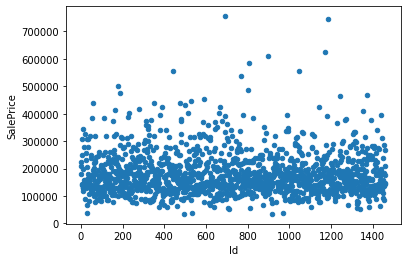

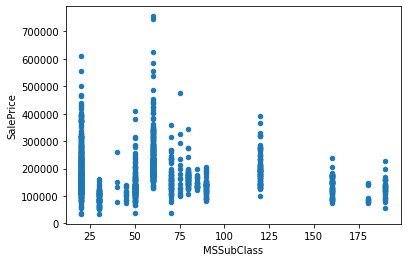

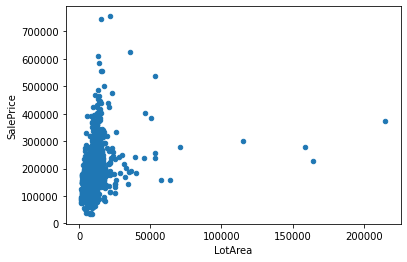

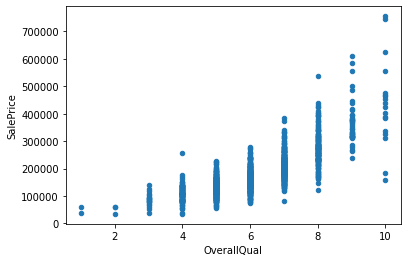

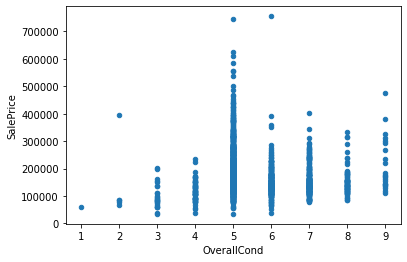

...

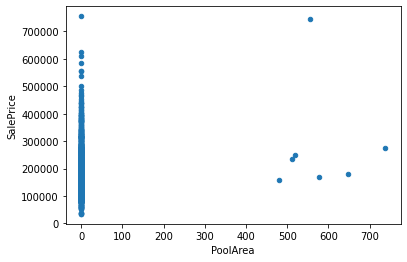

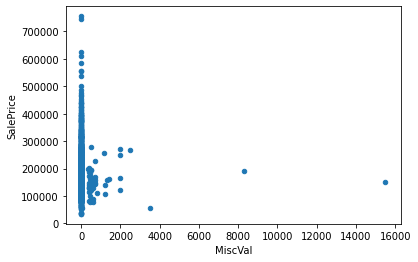

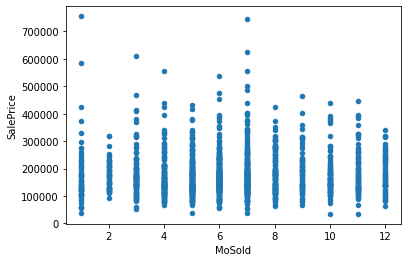

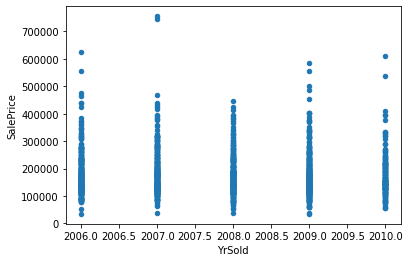

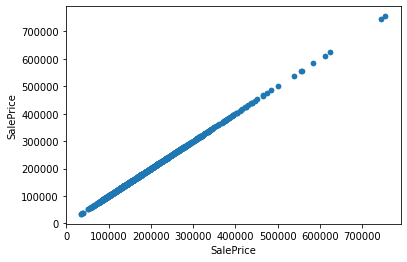

In [12]:
def data_graph(data):
    i = 0
    features_list = list(data)
    for number in features_list:
        var =  features_list[i]

        data = pd.concat([data_train['SalePrice'], data_train[var]], axis=1)
        data.plot.scatter(x=var, y='SalePrice')
        
        i = i + 1

data_graph(data_train.select_dtypes(include = ['float64', 'int64']).columns)

array([[<AxesSubplot:title={'center':'Id'}>,
        <AxesSubplot:title={'center':'MSSubClass'}>,
        <AxesSubplot:title={'center':'LotArea'}>,
        <AxesSubplot:title={'center':'OverallQual'}>,
        <AxesSubplot:title={'center':'OverallCond'}>,
        <AxesSubplot:title={'center':'YearBuilt'}>],
       [<AxesSubplot:title={'center':'YearRemodAdd'}>,
        <AxesSubplot:title={'center':'MasVnrArea'}>,
        <AxesSubplot:title={'center':'BsmtFinSF1'}>,
        <AxesSubplot:title={'center':'BsmtFinSF2'}>,
        <AxesSubplot:title={'center':'BsmtUnfSF'}>,
        <AxesSubplot:title={'center':'TotalBsmtSF'}>],
       [<AxesSubplot:title={'center':'1stFlrSF'}>,
        <AxesSubplot:title={'center':'2ndFlrSF'}>,
        <AxesSubplot:title={'center':'LowQualFinSF'}>,
        <AxesSubplot:title={'center':'GrLivArea'}>,
        <AxesSubplot:title={'center':'BsmtFullBath'}>,
        <AxesSubplot:title={'center':'BsmtHalfBath'}>],
       [<AxesSubplot:title={'center':'FullBath'}>,

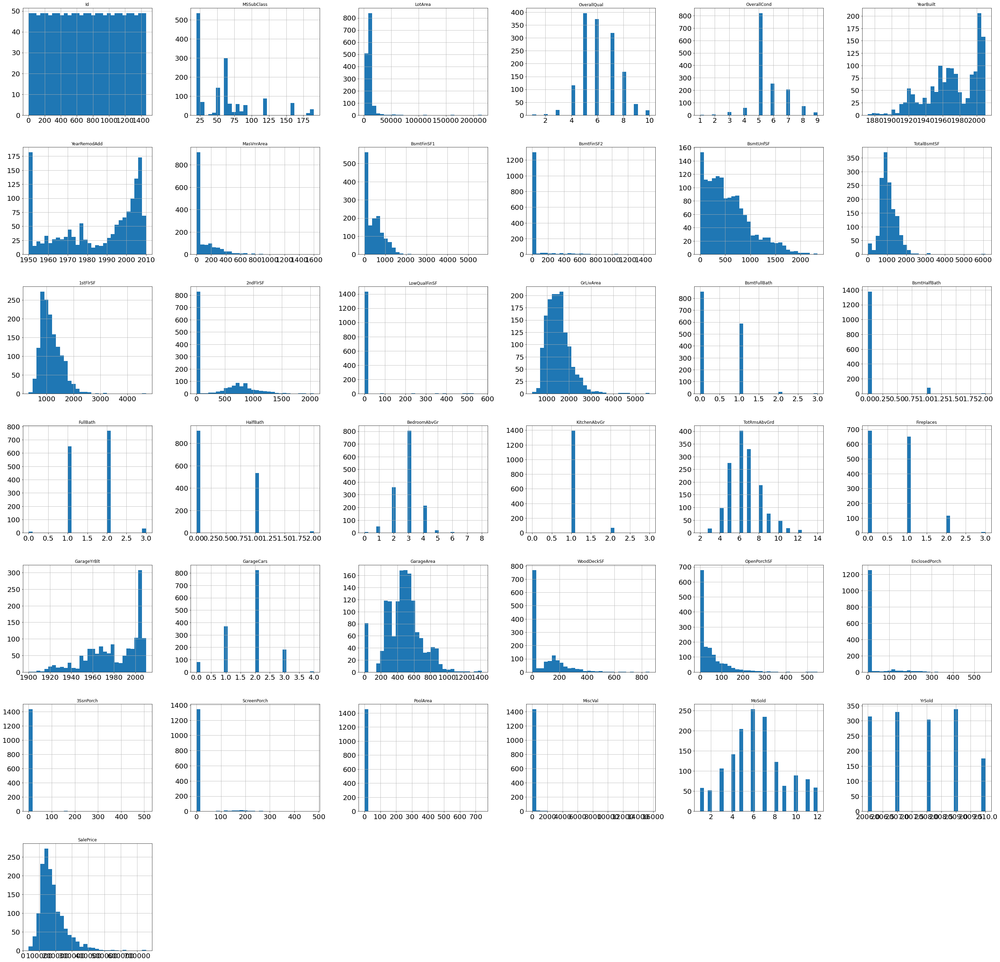

In [13]:
data_train.hist(figsize=(50, 50), bins=30, xlabelsize=20, ylabelsize=20)

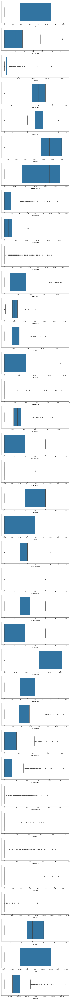

In [14]:
features = data_train.select_dtypes(include = ['float64', 'int64']).columns
fig, axes = plt.subplots(nrows=len(features), ncols=1)
fig.set_size_inches(10, 150)
for i, col in enumerate(features):
    sns.boxplot(data_train[col], ax=axes[i])
plt.show()

Після того як закінчили аналізувати графіки можемо зробити заміну катерігоріальних значень на дискретні
Для цього використаємо LabelEncoder та one-hot encoding.
Після цієї процедури в нас буде нерівномірна кільеість фіч у треніровачному та тестовому варіанті. Для цього перевіримо їх за допомою inner join та видалимо зайві

In [15]:
# Если количество уникальных категориальных значений в столбце 2 то импользуем LabelEncoder
le = LabelEncoder()
for col in data_train:
    if data_train[col].dtype == 'object':
        # Если 2 или меньше уникальных категорий
        if len(list(data_train[col].unique())) <= 2:
            # Тренируемся на обучающих данных
            le.fit(data_train[col])
            # Преобразование данных
            data_train[col] = le.transform(data_train[col])
            data_test[col] = le.transform(data_test[col])

# Если больше то one-hot encoding
data_train = pd.get_dummies(data_train)
data_test = pd.get_dummies(data_test)

print('Размер обучающих данных: ', data_train.shape)
print('Размер тестовых данных: ', data_test.shape)



Размер обучающих данных:  (1460, 268)
Размер тестовых данных:  (1459, 252)


In [16]:
# Выровняем таблицы по размеру обучающих и тренировачных данных.
# Для этого сохраним значения столбца 'SalePrice'
train_labels = data_train['SalePrice']

# Проверим на одинаковые столбцы две таблицы и удалим которые не совпадают
data_train, data_test = data_train.align(data_test, join = 'inner', axis = 1)

# Обратно вернем в обучающие данные значение 'TARGET'
data_train['SalePrice'] = train_labels

print('Размер обучающих данных: ', data_train.shape)
print('Размер тестовых данных: ', data_test.shape)

Размер обучающих данных:  (1460, 253)
Размер тестовых данных:  (1459, 252)


In [17]:
# Количество столбцов каждого типа
data_train.dtypes.value_counts()

uint8      213
int64       35
int32        3
float64      2
dtype: int64

Подивимося на матриці кореляції для числових та усіх значень.
Як бачимо є дуже велика кореляція між деякими фічами, тому видалимо їх та перевіримо матриці знову

In [18]:
correlation_matrix = abs(num_train.corr())
mask = np.triu(correlation_matrix)
fig, ax = plt.subplots(figsize=(150, 150))
ax = sns.heatmap(correlation_matrix, mask=mask, vmax=0.9, square=True, annot=True)
print('Размер обучающих данных: ', num_train.shape)
print('Размер тестовых данных: ', num_train.shape)

Размер обучающих данных:  (1460, 38)
Размер тестовых данных:  (1460, 38)


In [19]:
correlation_matrix = abs(data_train.corr())
mask = np.triu(correlation_matrix)
fig, ax = plt.subplots(figsize=(150, 150))
ax = sns.heatmap(correlation_matrix, mask=mask, vmax=0.9, square=True, annot=True)
print('Размер обучающих данных: ', data_train.shape)
print('Размер тестовых данных: ', data_test.shape)

Размер обучающих данных:  (1460, 253)
Размер тестовых данных:  (1459, 252)


In [20]:
# Почистим нашу матрицу от высоких значений корреляции
train_high_corr = data_train.copy()
train_high_corr.drop(['SalePrice'], axis='columns', inplace=True)

def delete_high_corr(correlation_matrix):
    high_correlation_set = set()
    counter = 0
    data_train_columns = list(data_train)
    for i in range(len(correlation_matrix)):
        for j in range(i + 1, len(correlation_matrix)):
            if abs(correlation_matrix[data_train_columns[i]][data_train_columns[j]]) > 0.9:
                high_correlation_set.add(data_train_columns[j])
                counter = counter + 1
    print('Удалены такие колонки')
    for feature in high_correlation_set:
        print(feature)
        data_train.drop(feature, axis='columns', inplace=True)
        data_test.drop(feature, axis='columns', inplace=True)
        
delete_high_corr(train_high_corr.corr())

Удалены такие колонки
SaleCondition_Partial
ExterQual_TA
Exterior2nd_CBlock
Exterior2nd_MetalSd
LandSlope_Mod
Exterior2nd_VinylSd
LotShape_Reg
RoofStyle_Hip
Exterior2nd_CmentBd


In [21]:
correlation_matrix = abs(num_train.corr())
mask = np.triu(correlation_matrix)
fig, ax = plt.subplots(figsize=(150, 150))
ax = sns.heatmap(correlation_matrix, mask=mask, vmax=0.9, square=True, annot=True)
print('Размер обучающих данных: ', num_train.shape)
print('Размер тестовых данных: ', num_train.shape)

Размер обучающих данных:  (1460, 38)
Размер тестовых данных:  (1460, 38)


In [22]:
correlation_matrix = abs(data_train.corr())
mask = np.triu(correlation_matrix)
fig, ax = plt.subplots(figsize=(150, 150))
ax = sns.heatmap(correlation_matrix, mask=mask, vmax=0.9, square=True, annot=True)
print('Размер обучающих данных: ', data_train.shape)
print('Размер тестовых данных: ', data_test.shape)

Размер обучающих данных:  (1460, 244)
Размер тестовых данных:  (1459, 243)


Після цього подивимося, у вигляді простої таблиці на найбільші значення кореляції з 'SalePrice' та на матрицю кореляції вище та зробимо такі висновки
1. Можна поєксперементувати та удалити ще більше колонок з меншою кореляцію (наприклад 70-80%)
2. Також можна поексперементувати з колонками наприклад GarageCars та GarageArea . Логічно, що вони прямолінійно залежні. Таких фіч багато тут, і всі вони могуть призвести до оверфіту

In [23]:
# Найдем корреляцию с 'SalePrice'
correlations = correlation_matrix['SalePrice'].sort_values()

print('\nНаибольшая корреляция:\n', correlations.tail(20))


Наибольшая корреляция:
 ExterQual_Gd        0.452466
Fireplaces          0.466929
MasVnrArea          0.472614
Foundation_PConc    0.497734
BsmtQual_TA         0.498545
KitchenQual_Ex      0.504094
YearRemodAdd        0.507101
GarageFinish_Unf    0.513906
KitchenQual_TA      0.519298
YearBuilt           0.522897
TotRmsAbvGrd        0.533723
BsmtQual_Ex         0.553105
FullBath            0.560664
1stFlrSF            0.605852
TotalBsmtSF         0.613581
GarageArea          0.623431
GarageCars          0.640409
GrLivArea           0.708624
OverallQual         0.790982
SalePrice           1.000000
Name: SalePrice, dtype: float64


## Моделювання

Для цьєї задачі я вибрав такий варіант:
https://i.imgur.com/QBuDOjs.jpg

Що тут відбувається?

Ми маємо на початку 5 моделей, які працюють з даними з EDA. Кожна модель (1-5) окремо і незалежно навчається з різними даними з тренувальних сету даних. Тренувальний сет даних розбивається на 5 частин. Де 4/5 це дані для навчання, решта для валідації. Результати валідації ми записуємо в окрему матрицю. Дана матриця буде служити навчальними даними для мета-моделі.
Тестові дані ми також проженемо через дані моделі щоб отримати матрицю даних для прогнозування на нашій мета-моделі.

За закінченню всіх операцій ми зможемо отримати як мінімум 2 моделі:
1. Грунтується на середньому значенні з прогнозування в перших 5 моделях
2. Грунтується на значеннях з прогнозування мета-моделе.
3. (Це вже мої експерімет) Почати комбінувати обидва вище описаних результату для отримання більш точної моделі.

In [24]:
# Подготовка к моделированию, удаляем ненужную колонку 'Id'

test_id = data_test['Id']

data_train.drop(['Id'], axis='columns', inplace=True)
data_test.drop(['Id'], axis='columns', inplace=True)

KFold - Надає індекси для навчання / тестування для розділення даних на набори для навчання / тестування.

In [25]:
# Делим тренировачные данные на данные тренировки и валидации

data_train_x = data_train.copy()
data_train_y = data_train['SalePrice'].copy()

data_train_x.drop(['SalePrice'], axis='columns', inplace=True)

from sklearn.model_selection import KFold, cross_val_score, train_test_split

kf = KFold(n_splits = 5, shuffle = True, random_state = 2)
kf.get_n_splits(data_train_x)


5

GradientBoostingRegressor, XGBRegressor, LGBMRegressor - це різні реалізації підвищення градієнту. Підвищення градієнта - це метод машинного навчання для задач регресії і класифікації, який створює модель прогнозування в формі ансамблю слабких моделей прогнозування, зазвичай дерев рішень.

ElasticNet - У статистиці і, зокрема, при підборі моделей лінійної або логістичної регресії еластична мережа являє собою метод регуляризоване регресії, який лінійно об'єднує штрафи L₁ і L₂ методів Лассо і Ріджа.

RandomForestRegressor - метаоценка, яка відповідає ряду класифікаційних дерев рішень для різних підвибірок набору даних і використовує усереднення для підвищення точності прогнозування і контролю надмірної підгонки.

Lasso - Лінійна модель, навчена з L1 до регуляризатора (також відома як Лассо). Технічно модель Lasso оптимізує ту ж цільову функцію, що і Elastic Net (без штрафу L2).

In [26]:
model_GBoost = GradientBoostingRegressor()
model_xgb = xgb.XGBRegressor()
model_lgb = lgb.LGBMRegressor()
model_ElasticNet = ElasticNet()
model_RandomForest = RandomForestRegressor(max_depth=6)

listModels = [model_GBoost, model_xgb, model_lgb, model_ElasticNet, model_RandomForest ]

In [27]:
train_for_last_model = np.zeros((data_train_x.shape[0], len(listModels)))
test_for_last_model = np.zeros((len(listModels), data_test.shape[0] ))
model_collection_sum = np.zeros((data_test.shape[0]))

for i, model in enumerate(listModels):
    k = 0
    for train_index, holdout_index in kf.split(data_train_x):
        model_clone = clone(model)
        
        x_train = data_train_x.iloc[train_index]
        y_train = data_train_y.iloc[train_index]

        x_test = data_train_x.iloc[holdout_index]

        model_clone.fit(x_train, y_train)
        train_pred = model_clone.predict(x_train)
        valid_pred = model_clone.predict(x_test)

        test_pred = model_clone.predict(data_test)
        if (k==i):
            model_collection_sum = model_collection_sum + test_pred
            
            predicted_prices = test_pred
            submission = pd.DataFrame({'Id': test_id, 'SalePrice': predicted_prices})
            submission.to_csv('submission'+ str(i)+'.csv', index = False)

        train_for_last_model[holdout_index,i] = valid_pred
        test_for_last_model[i] = test_pred
        
        k=k+1
        

test_for_last_model = test_for_last_model.transpose()


In [28]:
# для последующей проверки объединенных 5 моделей
train_predict_model5 = np.zeros((train_for_last_model.shape[0]))
for i, col in enumerate (train_for_last_model):
    train_predict_model5[i] = col.mean()

### Мета - модель

In [29]:
lasso = Lasso(alpha=0.1)
lasso.fit(train_for_last_model, data_train_y)
train_predict_meta = lasso.predict(train_for_last_model)
main_model_predict = lasso.predict(test_for_last_model)


### Варіанти остаточного результату та метрики

1. explained_variance_score - обчислює бал дисперсії регресії. Найкраща можлива оцінка - 1.0, більш низькі значення - гірше.
2. max_error - максимальна помилка
3. mean_absolute_error - середня абсолютна помилка
4. sqrt (mean_squared_error) - корінь з середньоквадратичної помилки
5. mean_absolute_percentage_error - середня абсолютна помилка у відсотках
6. r2_score - Функція обчислює коефіцієнт детермінації, як правило, позначений як r². Оскільки така дисперсія залежить від набору даних, R² не може бути значимо порівнянним для різних наборів даних. Найкраща можлива оцінка - 1,0, і вона може бути негативною (бо модель може бути довільно гірше).

In [30]:
predicted_prices = model_collection_sum/5
submission = pd.DataFrame({'Id': test_id, 'SalePrice': predicted_prices})
submission.to_csv('submission5Models.csv', index = False)

In [31]:
print("D         = ", explained_variance_score(data_train_y, train_predict_model5))
print("Max  er   = ", max_error(data_train_y, train_predict_model5))
print("Abso er   = ", mean_absolute_error(data_train_y, train_predict_model5))
print("SQRT er   = ", np.sqrt(mean_squared_error(data_train_y, train_predict_model5)))
print("% Abso er = ",  mean_absolute_percentage_error(data_train_y, train_predict_model5))
print("R2        = ", r2_score(data_train_y, train_predict_model5))

D         =  0.8576542787527858
Max  er   =  468180.64563862
Abso er   =  15845.760542473066
SQRT er   =  29963.517190947532
% Abso er =  0.09115745449283429
R2        =  0.857643497906711


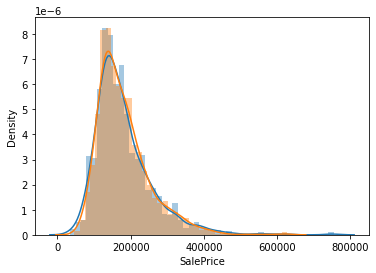

In [32]:
sns.distplot(data_train['SalePrice']);
sns.distplot(train_predict_model5);

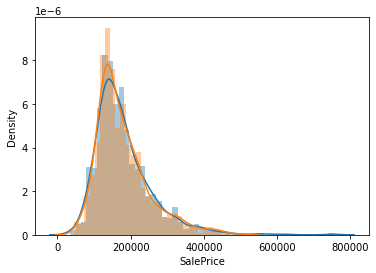

In [33]:
sns.distplot(data_train['SalePrice']);
sns.distplot(predicted_prices);

In [34]:
predicted_prices = main_model_predict
submission = pd.DataFrame({'Id': test_id, 'SalePrice': predicted_prices})
submission.to_csv('submissionMain.csv', index = False)

In [35]:
print("D         = ", explained_variance_score(data_train_y, train_predict_meta))
print("Max  er   = ", max_error(data_train_y, train_predict_meta))
print("Abso er   = ", mean_absolute_error(data_train_y, train_predict_meta))
print("SQRT er   = ", np.sqrt(mean_squared_error(data_train_y, train_predict_meta)))
print("% Abso er = ",  mean_absolute_percentage_error(data_train_y, train_predict_meta))
print("R2        = ", r2_score(data_train_y, train_predict_meta))

D         =  0.8701643906352586
Max  er   =  420439.35246001696
Abso er   =  16042.147889380933
SQRT er   =  28615.480759781443
% Abso er =  0.09281822193354444
R2        =  0.8701643906352585


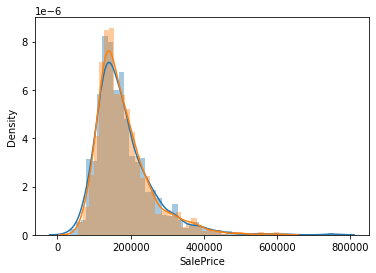

In [36]:
sns.distplot(data_train['SalePrice']);
sns.distplot(train_predict_meta);

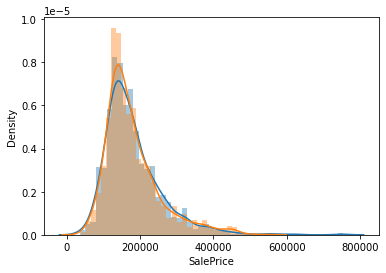

In [37]:
sns.distplot(data_train['SalePrice']);
sns.distplot(predicted_prices);

In [38]:
predicted_prices = (model_collection_sum/5 + main_model_predict)/2
train_predict_v1 = (train_predict_model5/5 + train_predict_meta)/2
submission = pd.DataFrame({'Id': test_id, 'SalePrice': predicted_prices})
submission.to_csv('submission52.csv', index = False)

In [39]:
print("D         = ", explained_variance_score(data_train_y, train_predict_v1))
print("Max  er   = ", max_error(data_train_y, train_predict_v1))
print("Abso er   = ", mean_absolute_error(data_train_y, train_predict_v1))
print("SQRT er   = ", np.sqrt(mean_squared_error(data_train_y, train_predict_v1)))
print("% Abso er = ",  mean_absolute_percentage_error(data_train_y, train_predict_v1))
print("R2        = ", r2_score(data_train_y, train_predict_v1))

D         =  0.7285624239814086
Max  er   =  414526.11338218267
Abso er   =  72963.47120869682
SQRT er   =  83338.60255122298
% Abso er =  0.3926390422484325
R2        =  -0.10124551999804288


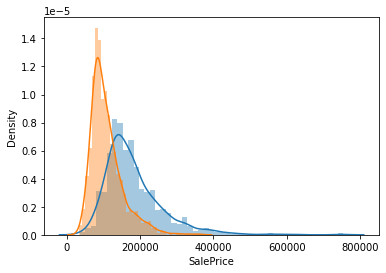

In [40]:
sns.distplot(data_train['SalePrice']);
sns.distplot(train_predict_v1);

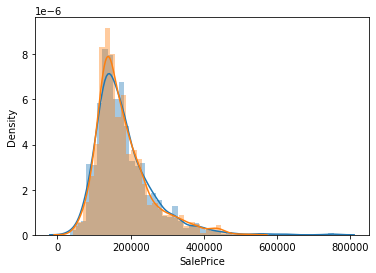

In [41]:
sns.distplot(data_train['SalePrice']);
sns.distplot(predicted_prices);

In [42]:
predicted_prices = (model_collection_sum + main_model_predict)/6
train_predict_v2 = (train_predict_model5 + train_predict_meta)/6
submission = pd.DataFrame({'Id': test_id, 'SalePrice': predicted_prices})
submission.to_csv('submission6.csv', index = False)

In [43]:
print("D         = ", explained_variance_score(data_train_y, train_predict_v2))
print("Max  er   = ", max_error(data_train_y, train_predict_v2))
print("Abso er   = ", mean_absolute_error(data_train_y, train_predict_v2))
print("SQRT er   = ", np.sqrt(mean_squared_error(data_train_y, train_predict_v2)))
print("% Abso er = ",  mean_absolute_percentage_error(data_train_y, train_predict_v2))
print("R2        = ", r2_score(data_train_y, train_predict_v2))

D         =  0.4768255944008378
Max  er   =  567564.0472301204
Abso er   =  120633.99353466622
SQRT er   =  133554.62263827227
% Abso er =  0.6596415148524801
R2        =  -1.828196472208751


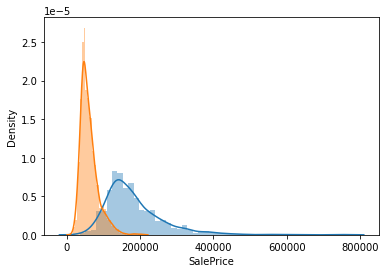

In [44]:
sns.distplot(data_train['SalePrice']);
sns.distplot(train_predict_v2);

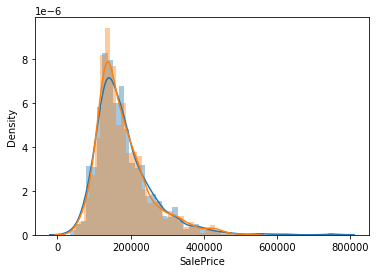

In [45]:
sns.distplot(data_train['SalePrice']);
sns.distplot(predicted_prices);

Як бачимо якісь додаткові моделі окрім 1 і 2 варіантів можна вважати жахливими. Тому що метрики показують результат гірше, хоча результати submission іноді дають навіть результат краще.

# Висновок

У даній розрахунково-графічній роботі були розроблені 2 моделі, які розраховують приблизну оцінку житла на основі багатьох фіч.
Була проведела розвідка даних, видалені значення з високим коефіцієнтом кореляцції та пропущенних значень. Залишені пропущенні значення були заповненні модою. При моделюванні використовувалось усього 6 моделей.

У результаті були прикріплені метрики, та побудовані графіки густини 'SalePrice' у треніровачному наборі та предсказання для тестових даних. 